# Import and set colors

In [1]:
#Import packages
import scanpy as sc
import anndata as ann
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import cm, colors
from gprofiler import gprofiler

import os 

import seaborn as sb

In [2]:
plt.rcParams['figure.figsize']=(4,3) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=300,transparent=False, fontsize=12, color_map='plasma')
sc.logging.print_header()

scanpy==1.7.1 anndata==0.7.6 umap==0.5.1 numpy==1.21.2 scipy==1.8.1 pandas==1.2.3 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.4


In [3]:
#Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

# Set project file paths

In [4]:
file_path = '/Volumes/Seagate_Exp/Paper_sc_analysis/' 
#this is my file path please adapt it to your directory

In [5]:
data_dir = '/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/data_scVI/' 

In [6]:
sc.settings.figdir = file_path + 'figures_earlytp/'

In [7]:
import datetime

today = datetime.date.today().strftime('%y%m%d') #creates a YYMMDD string of today's date

# Read Data & downstream analysis

In [8]:
adata_postnorm = sc.read('/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/data_scVI/adata_postnorm_no13_scvi_mde.h5ad')

In [9]:
adata_postnorm

AnnData object with n_obs × n_vars = 55216 × 19290
    obs: 'sample_id', 'sample_id_str', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'sample', 'experiment', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'batch_colors', 'condition_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'sample_id_str_colors', 'umap'
    obsm: 'X_mde', 'X_pca', 'X_scVI', 'X_umap'
    varm: 'PCs'
    layers: 'coun

# Visualization with batch correction (scVI)

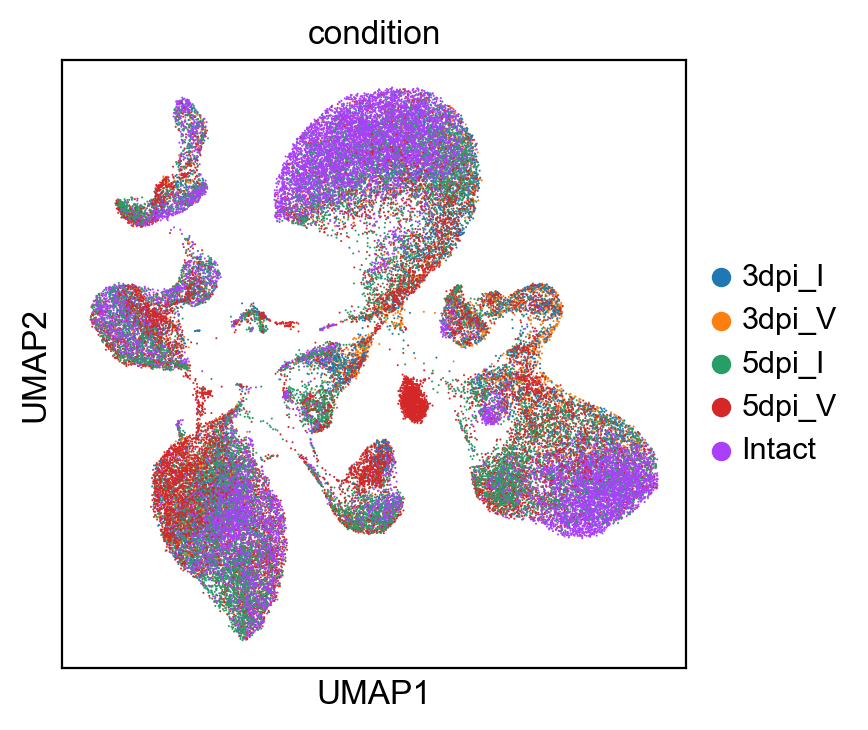

In [10]:
sc.pl.umap(adata_postnorm, color='condition')

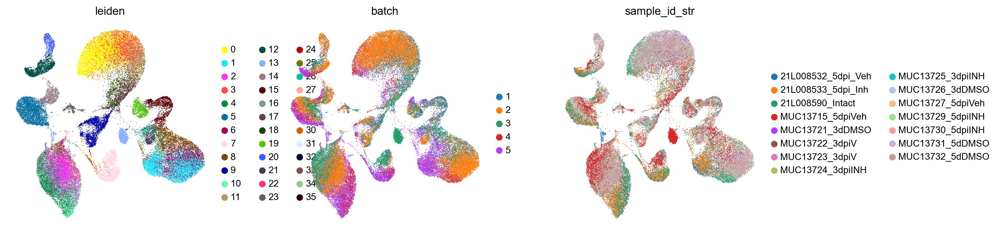

In [11]:
sc.pl.umap(adata_postnorm, color=['leiden','batch','sample_id_str'], legend_fontsize =float(10), legend_fontweight= 'normal', frameon= False, )

In [12]:
adata_proc = adata_postnorm[~np.in1d(adata_postnorm.obs['leiden'], #remove cluster 13 only drom one batch and multiple identity
                           ['13'])].copy()

In [13]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_proc, use_rep="X_scVI")

computing neighbors


OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)


In [14]:
sc.tl.umap(adata_proc,random_state=1)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:31)


In [15]:
# neighbors were already computed using scVI
sc.tl.leiden(adata_proc, key_added="leiden_scVI")

running Leiden clustering
    finished: found 36 clusters and added
    'leiden_scVI', the cluster labels (adata.obs, categorical) (0:00:07)


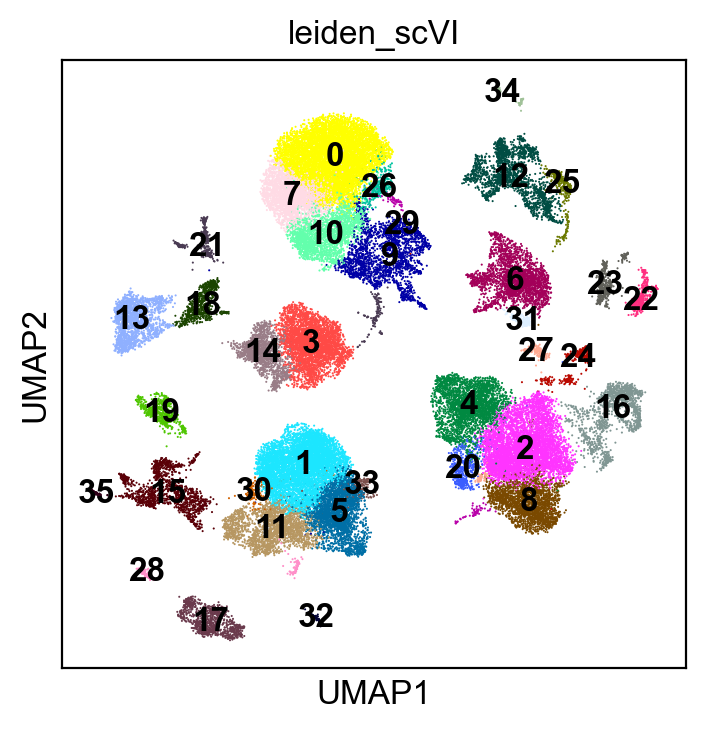

In [16]:
sc.pl.umap(adata_proc, color=['leiden_scVI'], legend_loc='on data')

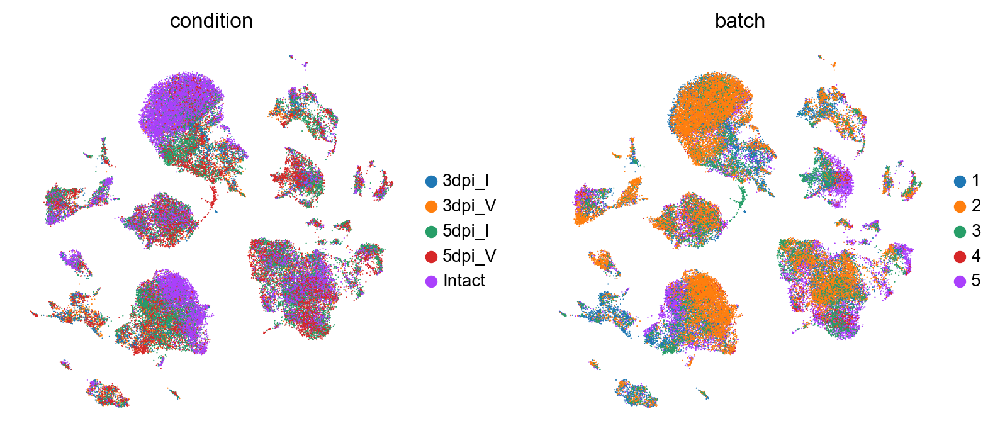

In [17]:
sc.pl.umap(adata_proc, color=['condition','batch'], legend_fontsize =float(10), legend_fontweight= 'normal', frameon= False)

In [18]:
print(adata_proc.obs['condition'].value_counts())

Intact    16649
5dpi_I    15142
5dpi_V    13766
3dpi_I     4613
3dpi_V     3643
Name: condition, dtype: int64


In [19]:
intact_subsam = sc.pp.subsample(adata_proc[adata_proc.obs['condition']=='Intact'],n_obs=3637,copy=True).obs_names
five_dpi_I_subsam = sc.pp.subsample(adata_proc[adata_proc.obs['condition']=='5dpi_I'],n_obs=3637,copy=True).obs_names
five_dpi_V_subsam = sc.pp.subsample(adata_proc[adata_proc.obs['condition']=='5dpi_V'],n_obs=3637,copy=True).obs_names
three_dpi_I_subsam = sc.pp.subsample(adata_proc[adata_proc.obs['condition']=='3dpi_I'],n_obs=3637,copy=True).obs_names
three_dpi_V_subsam = sc.pp.subsample(adata_proc[adata_proc.obs['condition']=='3dpi_V'],n_obs=3637,copy=True).obs_names
adata_proc_subsam = adata_proc[list(intact_subsam) + list(five_dpi_I_subsam)+ list(five_dpi_V_subsam)+list(three_dpi_I_subsam)+list(three_dpi_V_subsam)].copy()

In [20]:
sc.tl.embedding_density(adata_proc_subsam, basis='umap', groupby='condition')

computing density on 'umap'
--> added
    'umap_density_condition', densities (adata.obs)
    'umap_density_condition_params', parameter (adata.uns)


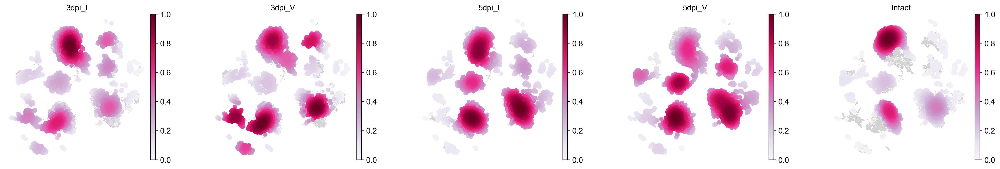

In [21]:
sc.pl.embedding_density(adata_proc_subsam, basis='umap',  key='umap_density_condition', color_map='PuRd', wspace=0.3, bg_dotsize = 8, frameon= False, ncols=5, save='_4A_distribution_downscaling.png')

## Cell cycle

In [22]:
cell_cycle_genes = [x.strip() for x in open('/Volumes/Seagate_Exp/Single_cell_112020/regev_lab_cell_cycle_genes_mouse.txt')]

In [23]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_proc.var_names]

In [24]:
sc.tl.score_genes_cell_cycle(adata_proc, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    684 total control genes are used. (0:00:02)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    728 total control genes are used. (0:00:02)
-->     'phase', cell cycle phase (adata.obs)


In [25]:
pair2= ["#009B77", "#ff8080", "#ffbf00", "#9AD255", "#9AD255",
       "#b30047",   "#dada2b", "#dada2b"]

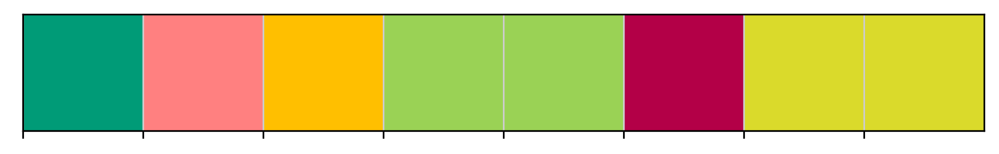

In [26]:
sb.palplot(pair2)

... storing 'phase' as categorical


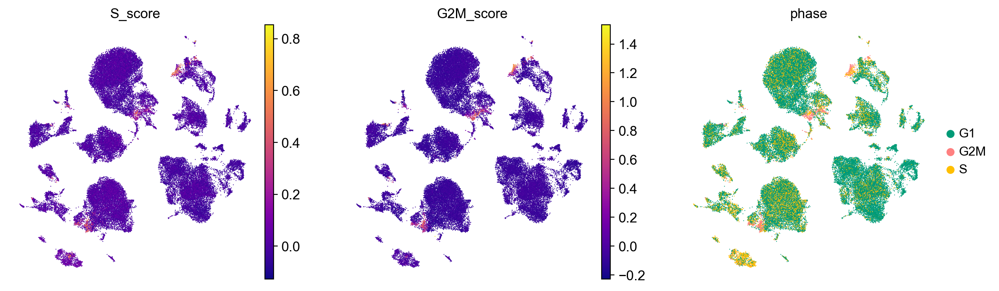

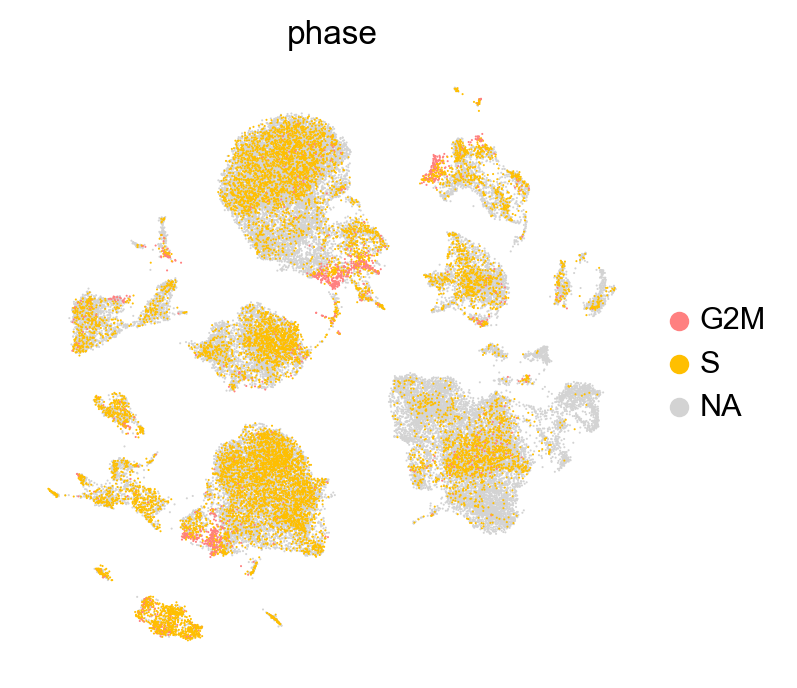

In [27]:
sc.pl.umap(adata_proc, color=['S_score', 'G2M_score', 'phase'],palette=pair2, use_raw=False, frameon=False, )
sc.pl.umap(adata_proc, color='phase',groups=['G2M','S'],  palette=pair2, use_raw=False, frameon=False)

In [28]:
sc.tl.score_genes(adata_proc, list(cell_cycle_genes), score_name='Cycling cells' )

computing score 'Cycling cells'
    finished: added
    'Cycling cells', score of gene set (adata.obs).
    992 total control genes are used. (0:00:02)


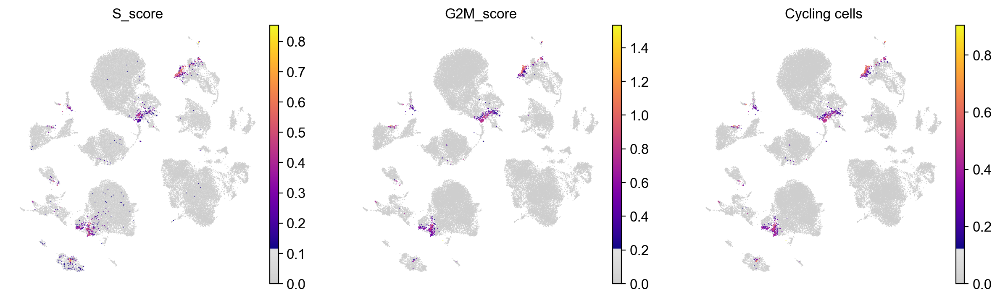

In [29]:
sc.pl.umap(adata_proc, color=['S_score', 'G2M_score', 'Cycling cells'],palette=pair2, use_raw=False, frameon=False, cmap=mymap2, vmin=0)

In [30]:
Ccc = adata_proc.obs['Cycling cells'] >0

In [31]:
Ccc

AAACCCACAACAGCTT    False
AAACCCACAGCGACCT    False
AAACCCATCCACCTCA    False
AAACCCATCCATCGTC    False
AAACCCATCTGAGAGG    False
                    ...  
TTTGTCATCACAATGC    False
TTTGTCATCCAACCAA    False
TTTGTCATCCTTGGTC    False
TTTGTCATCGATCCCT    False
TTTGTCATCTTGAGAC    False
Name: Cycling cells, Length: 53813, dtype: bool

In [32]:
adata_proc.obs['cell_cycle'] = Ccc
adata_proc.obs['cell_cycle'] = adata_proc.obs['cell_cycle'].astype('category')

In [33]:
cluster2annotation = {
    False : 'resting',
    True : 'cycling',
 }

In [34]:
adata_proc.obs['cell_cycle'] = adata_proc.obs['cell_cycle'].map(cluster2annotation).astype('category')

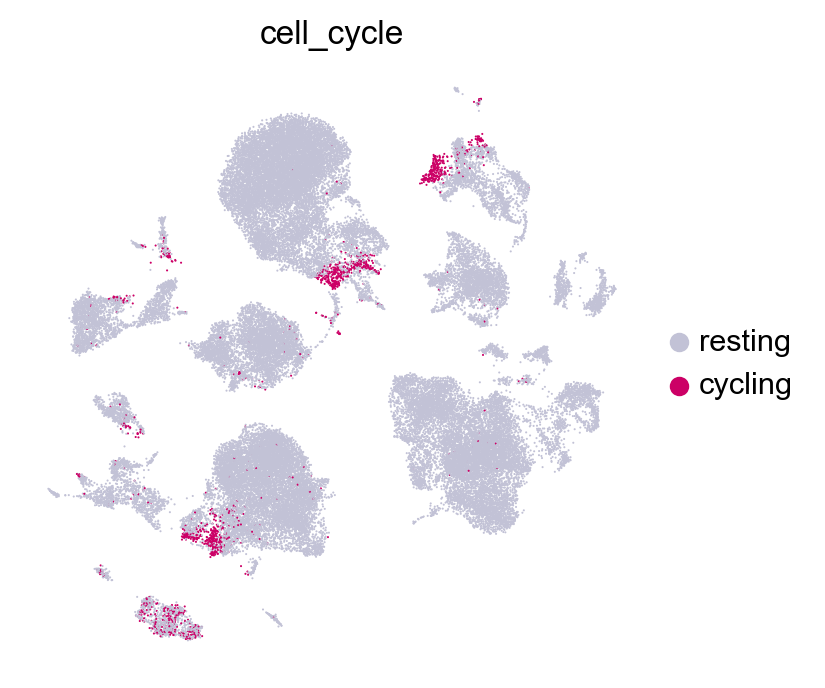

In [35]:
sc.pl.umap(adata_proc, color=['cell_cycle'],palette=['#c2c2d6', '#cc0066'], use_raw=False, frameon=False, cmap=mymap2, vmin=0)

In [36]:
adata_proc.obs['cell_cycle'].value_counts()

resting    52294
cycling     1519
Name: cell_cycle, dtype: int64

# Markers analysis

In [37]:
Markers_all_cells ={'Microglia': ['Tmem119', 'Cx3cr1', 'P2ry12', 'P2ry13', 'Gpr34', 'Olfml3', 'Selplg', 'Sparc', 'Fcrls', 'Siglech', 'Slc2a5','Mafb', 'Pmepa1', 'Cd14'],#Ochocka et al., 2021, van Hove et al., 2016
                   'DAM':['Lpl','Cst7'], #Ochocka et al., 2021,
                   'Macrophages':['Itga4', 'Tgfbi', 'Ifitm2', 'Ifitm3', 'Tagln2','F13a1', 'Kynu', 'S100a11', 'S100a6'],#Ochocka et al., 2021, van Hove et al., 2016
                   'BAM': [ 'Cd163', 'Mrc1','Lyve1', 'Siglec1'],#Ochocka et al., 2021, van Hove et al., 2016
                   'Monocytes':['Ly6c2','Ccr2','Spn'],#Ochocka et al., 2021,
                   'DCs':['Cd24a','Itgax','Bst2','Cd209a','Xcr1','Ccr7','Ccr9', 'Flt3','Itgae', 'Itgam','H2-Oa','Tnni2','Kctd14','Amica1','Kmo','Hepacam2'], 
                   'NKT cells':['Cd3e','Klrb1c','Ncr1'],
                   'T cells':['Cd3d','Cd3e','Cd3g','Lat','Bcl11b'],
                   'B cells':['Cd19', 'Ms4a1', 'Sdc1', 'Pax5', 'Ms4a1'],
                   'Neutrophils': ['Ly6g', 'Ngp', 'Camp', 'S100a9'],
                   'Neurons':['Rbfox3','Slc17a7','Gabra1', 'Cux1','Pou3f2','Bcl11b', 'Foxp2'],
                   'OPCs':['Pdgfra', 'C1ql1'],
                   'COPs':['Neu4', 'Brca1'],
                   'MOL':['Opalin', 'Ninj2'],
                   'Astrocytes':['Sox9', 'Gfap','Aldh1l1','Atp1b2', 'Vim','Gfap','Slc1a3','Aldoc'],
                   'Pericytes':['Pecam1','Pdgfrb', 'Higd1b','Ndufa4l2','Rgs5','Kcnj8','Flt1'],
                   'VSMCs':['Acta2', 'Tagln','Myh11', 'Mustn1','Map3k7cl'],
                   'VLMCs':['Mgp', 'Slc47a1',  'Thbd', 'Col1a1', 'Col1a2'],
                   'VECV': ['Ly6c1','Cldn5', 'Ly6a','Pltp','Pglyrp1', 'Scgb3a1']
                  }

In [38]:
for names in list(Markers_all_cells):
 sc.tl.score_genes(adata_proc, Markers_all_cells[names], score_name=names )

computing score 'Microglia'
    finished: added
    'Microglia', score of gene set (adata.obs).
    250 total control genes are used. (0:00:02)
computing score 'DAM'
    finished: added
    'DAM', score of gene set (adata.obs).
    100 total control genes are used. (0:00:02)
computing score 'Macrophages'
    finished: added
    'Macrophages', score of gene set (adata.obs).
    349 total control genes are used. (0:00:02)
computing score 'BAM'
    finished: added
    'BAM', score of gene set (adata.obs).
    150 total control genes are used. (0:00:02)
computing score 'Monocytes'
    finished: added
    'Monocytes', score of gene set (adata.obs).
    150 total control genes are used. (0:00:02)
computing score 'DCs'
    finished: added
    'DCs', score of gene set (adata.obs).
    550 total control genes are used. (0:00:02)
computing score 'NKT cells'
    finished: added
    'NKT cells', score of gene set (adata.obs).
    100 total control genes are used. (0:00:02)
computing score 'T cells

In [39]:
sc.tl.rank_genes_groups(adata_proc, groupby='leiden_scVI',  method='t-test_overestim_var')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:44)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_leiden_scVI']`


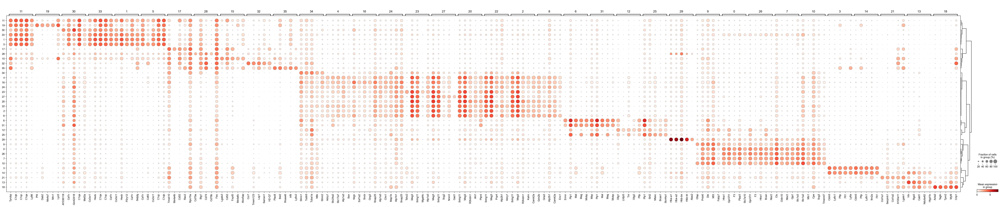

In [40]:
sc.pl.rank_genes_groups_dotplot(adata_proc, n_genes=5, key='rank_genes_groups' )

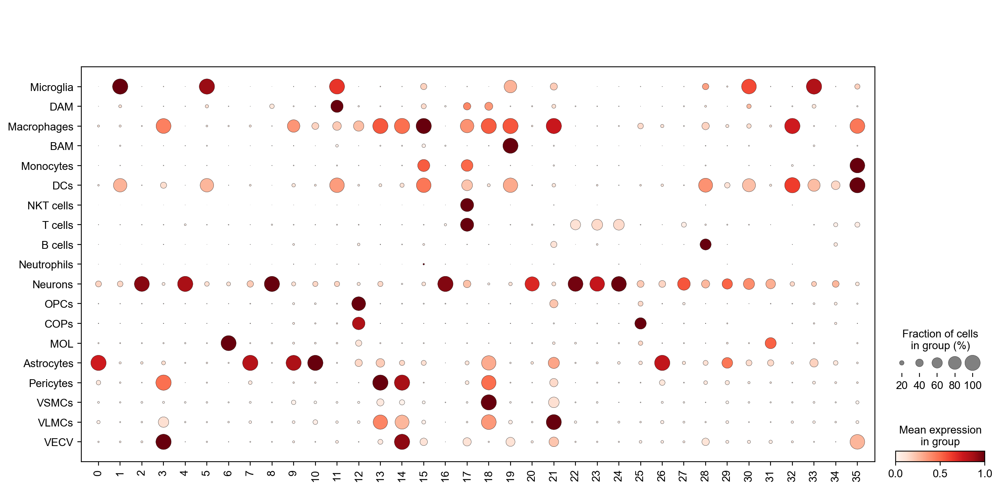

In [41]:
sc.pl.dotplot(adata_proc, list(Markers_all_cells),
              'leiden_scVI',  swap_axes=True, standard_scale='var',)
             # var_group_rotation=90, dendrogram=True, save='adata_ctr_proc_markers_ctrinjpng')


In [42]:
mg = []
scores = []
for i in range(0,36):
    mg = [j[i] for j in adata_proc.uns['rank_genes_groups']['names']][:50]
    scores = [j[i] for j in adata_proc.uns['rank_genes_groups']['scores']][:50]
    print('marker genes in louvain cluster: ' + str(i))
    for j in range (0,len(mg)):
        print(mg[j])
    print('-----------------')

marker genes in louvain cluster: 0
Htra1
Gpr37l1
F3
Plpp3
Slc7a10
Cldn10
Bcan
Slc1a3
Aldoc
Mfge8
Gja1
Ntsr2
Cxcl14
Gjb6
Btbd17
Msmo1
Atp1a2
Ndrg2
Pla2g7
Clu
S1pr1
Mt3
Acsl3
Kcnk1
Gm3764
Gstm5
Mt1
Cspg5
Prdx6
Ptprz1
Luzp2
Atp1b2
Gstm1
Apoe
Dclk1
Nkain4
Slc1a2
Tril
Mt2
Scg3
Fgfr3
Acsbg1
Mmd2
Tlcd1
Tspan7
Lsamp
Fjx1
Slc6a1
Ttyh1
Prnp
-----------------
marker genes in louvain cluster: 1
Cx3cr1
Hexb
P2ry12
Csf1r
Selplg
C1qa
Gpr34
Trem2
C1qc
C1qb
Siglech
Ctss
Laptm5
Olfml3
Tmem119
Fcrls
Lpcat2
Lgmn
Vsir
Fcgr3
Unc93b1
Rgs10
Ctsd
Tyrobp
Ly86
Fcer1g
Serinc3
Mafb
Sparc
Marcks
Hpgds
Ctsz
Cd53
Grn
Aif1
P2ry13
Pld4
Itgb5
Ifngr1
Cyba
Rnase4
Ptgs1
Cd68
Rhob
Rgs2
Ltc4s
Tgfbr1
Lair1
Ctsh
AF251705
-----------------
marker genes in louvain cluster: 2
Snhg11
Meg3
R3hdm1
Kalrn
Camk2a
Ptprd
Brinp3
Arpp21
Atp1a1
Rtn1
Syt1
mt-Nd1
2900055J20Rik
Pcsk2
A830036E02Rik
Snap25
C1qtnf4
Atp2b2
Syp
Mef2c
Gria2
Stx1a
Grin2b
Scn2a1
Slc17a7
Lingo1
Tmem191c
Clstn1
Tmem145
Cck
Nrxn1
Slc12a5
Gabrg2
Grin1
Matk
Kif1a
Tmem59l
T

In [43]:
cluster2annotation = {'0': '0_Astrocytes',
                      '1': '1_Microglia',
                      '2': '2_Neurons',
                      '3': '3_VECV',
                      '4': '4_Neurons',
                      '5': '5_Microglia',
                      '6': '6_MOL',
                      '7': '7_Astrocytes',
                      '8': '8_Neurons',
                      '9': '9_Astrocytes',
                      '10': '10_Astrocytes',
                      '11': '11_Microglia',
                      '12': '12_OPCs',
                      '13': '13_Pericytes',
                      '14': '14_Pericytes',
                      '15': '15_Macrophages',
                      '16': '16_Neurons',
                      '17': '17_NKT/T cells',
                      '18': '18_VSMCs',
                      '19': '19_BAM',
                      '20': '20_Neurons',
                      '21': '21_VLMCs',
                      '22': '22_Neurons',
                      '23': '23_Neurons',
                      '24': '24_Neurons',
                      '25': '25_COPs',
                      '26': '26_Astrocytes',
                      '27': '27_Neurons', 
                      '28': '28_B cells', 
                      '29': '29_Erythrocytes',
                      '30': '30_Microglia',
                      '31': '31_MOL',
                      '32': '32_DC',
                      '33': '33_Microglia',
                      '34': '34_Neurons',
                      '35': '35_Monocytes'
}

In [44]:
adata_proc.obs['annotated'] = adata_proc.obs['leiden_scVI'].map(cluster2annotation).astype('category')

In [45]:
color2 = ['#333399',#'0': '0_Astrocytes',
          '#DC143C' ,#'1': '1_Microglia',   
          '#008000',#'2': '2_Neurons',   
          '#BA55D3',#'3': '3_VECV',   
          '#9AD255',#'4': '4_Neurons',   
          '#fa6352',#'5': '5_Microglia',   
          '#fdd2ce',#'6': '6_MOL',   
          '#0066cc',#'7': '7_Astrocytes',   
          '#20B2AA',#'8': '8_Neurons',   
          '#b3d9ff',#'9': '9_Astrocytes',   
          '#bdcbf5',#'10': '10_Astrocytes',   
          '#ffb399',#'11': '11_DAM',   
          '#e6007a',#'12': '12_OPCs',   
          '#9985e0',#'13': '13_Pericytes',   
          '#bf4080',#''14': '14_Pericytes',   
          '#cc3333',#'15': '15_Macrophages',   
          '#8dd593',#'16': '16_Neurons',   
          '#ff6600',#'17': '17_NKT/T cells',   
          '#DA0AD3',#'18': '18_VSMCs',   
          '#801a00',#'19': '19_BAM',   
          '#006666',#'20': '20_Neurons',   
          '#d279a6',#'21': '21_VLMCs',   
          '#99ffbb',#'22': '22_Neurons',   
          '#20B2AA',#'23': '23_Neurons',   
          '#326732',#'24': '24_Neurons',   
          '#ffb3db',#'25': '25_COPs',   
          '#7d87b9',#'26': '26_Astrocytes',   
          '#009933',#'27': '27_Neurons', 
          '#996600',#'28': '28_DC',    
          '#efd6f5',#'29': '29_Erythrocytes',   
          '#990033',#'30': '30_Microglia',   
          '#fa9ef7',#'31': '31_MOL',   
          '#8e063b',#'32': '32_DC',   
          '#ff8c00',#'33': '33_Microglia',   
          '#666633',#'34': '34_',   
           '#ffbf00',#'35': '35_Monocytes'
         ]

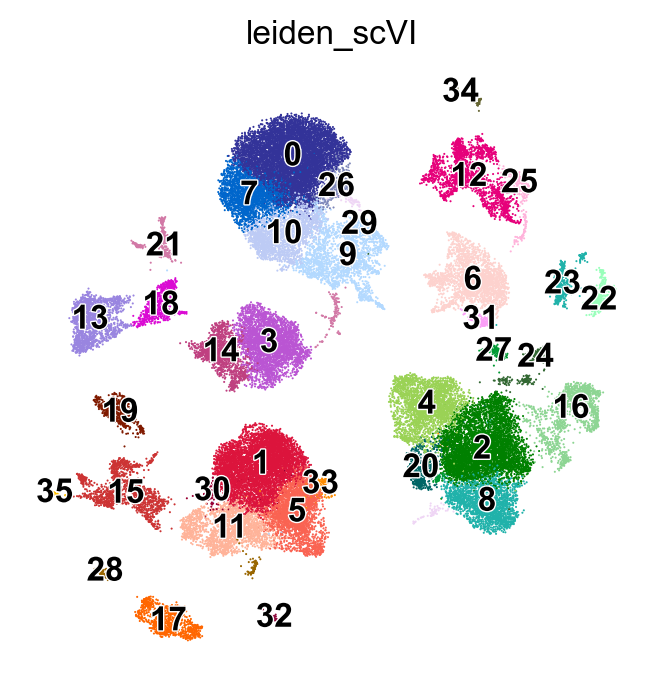

In [46]:
sc.pl.umap(adata_proc, color=['leiden_scVI'], legend_fontsize =float(12) , wspace=0.6, cmap=mymap2,palette=color2,
           legend_fontweight= 'bold', frameon= False , legend_loc='on data', legend_fontoutline=1, save=today+'_leiden_treated.png' )

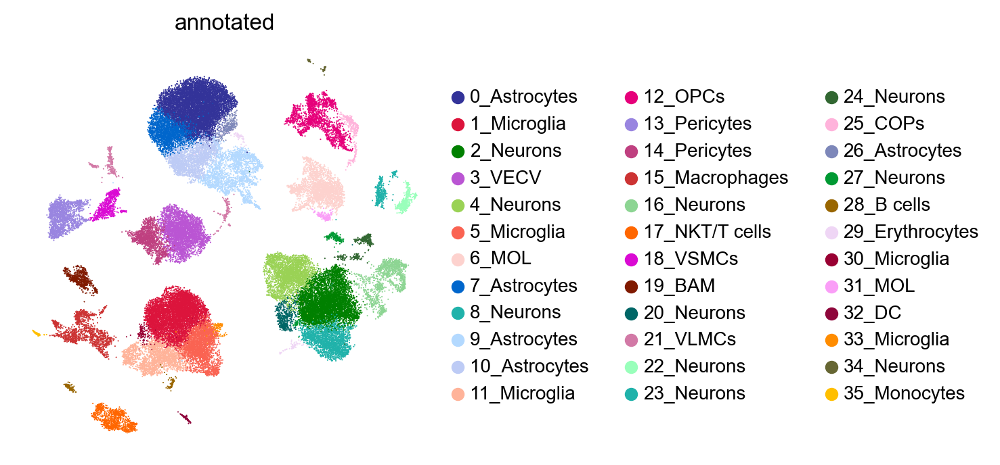

In [47]:
sc.pl.umap(adata_proc, color=['annotated'], legend_fontsize =float(10) , wspace=0.6, cmap=mymap2,palette=color2,
           legend_fontweight= 'normal', frameon= False, save=today+'_bbknn2_treated_annotated.png')

In [48]:
cond= ['#ffb3d9','#DC143C','#ffcc99','#ff9933',"#20B2AA",]

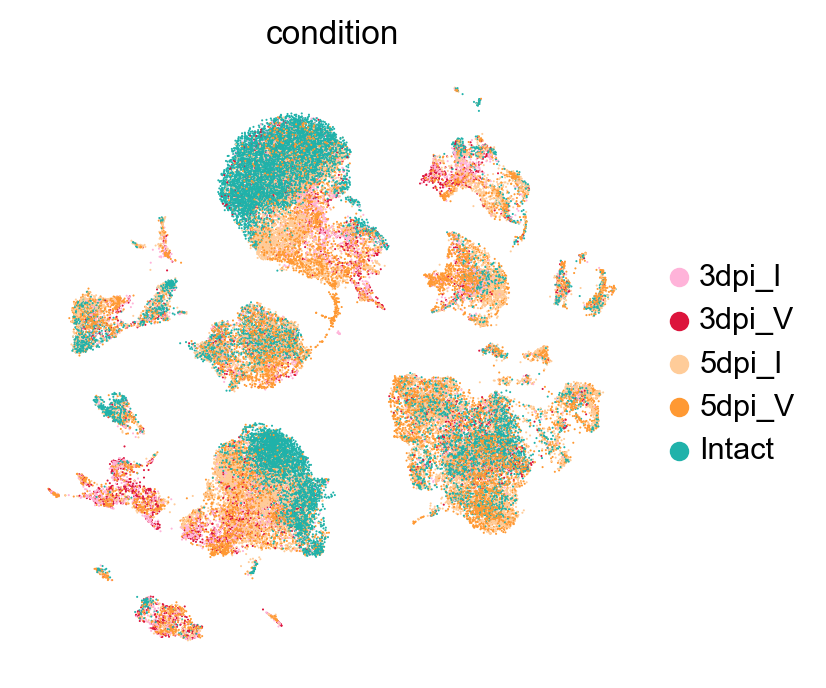

In [49]:
sc.pl.umap(adata_proc,color='condition',palette=cond, legend_fontweight= 'normal', frameon= False ,)

In [50]:
sc.tl.rank_genes_groups(adata_proc, groupby='annotated', key_added='rank_genes_treated_annotated', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_treated_annotated']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:43)


In [51]:
sc.tl.dendrogram(adata_proc, groupby= 'annotated')

    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_annotated']`


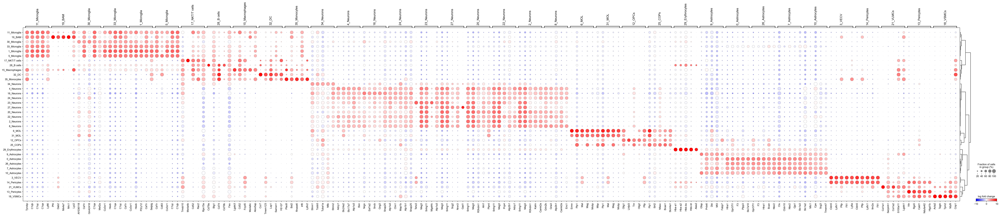

In [52]:
sc.pl.rank_genes_groups_dotplot(adata_proc, n_genes=5,values_to_plot='logfoldchanges',vmin=-10,vmax=10,cmap='bwr', key='rank_genes_treated_annotated' )

In [53]:
##### Rename sample to id to fit fastqIDs and nomenclature in the paper

In [54]:
sample_id_str2fastq_IDs = {
 '21L008532_5dpi_Veh':'21L008532_5dpi_CTRL',
 '21L008533_5dpi_Inh':'21L008533_5dpi_INH',
 '21L008590_Intact':'MUC29190_INT',
 'MUC13715_5dpiVeh':'MUC13715_5dpi_CTRL',
 'MUC13721_3dDMSO':'MUC13721_INT',
 'MUC13722_3dpiV':'MUC13722_3dpi_CTRL',
 'MUC13723_3dpiV':'MUC13723_3dpi_CTRL',
 'MUC13724_3dpiINH':'MUC13724_3dpi_INH',
 'MUC13725_3dpiINH':'MUC13725_3dpi_INH',
 'MUC13726_3dDMSO':'MUC13726_INT',
 'MUC13727_5dpiVeh':'MUC13727_5dpi_CTRL',
 'MUC13729_5dpiINH':'MUC13729_5dpi_INH',
 'MUC13730_5dpiINH':'MUC13730_5dpi_INH',
 'MUC13731_5dDMSO':'MUC13731_INT',
 'MUC13732_5dDMSO':'MUC13732_INT',
}

In [55]:
adata_proc.obs['sample_IDs'] = adata_proc.obs['sample_id_str'].map(sample_id_str2fastq_IDs).astype('category')

In [56]:
#dooble check annotation
pd.crosstab(adata_proc.obs['sample_id_str'],adata_proc.obs['sample_IDs'])

sample_IDs,21L008532_5dpi_CTRL,21L008533_5dpi_INH,MUC29190_INT,MUC13715_5dpi_CTRL,MUC13721_INT,MUC13722_3dpi_CTRL,MUC13723_3dpi_CTRL,MUC13724_3dpi_INH,MUC13725_3dpi_INH,MUC13726_INT,MUC13727_5dpi_CTRL,MUC13729_5dpi_INH,MUC13730_5dpi_INH,MUC13731_INT,MUC13732_INT
sample_id_str,,,,,,,,,,,,,,,
21L008532_5dpi_Veh,7440,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21L008533_5dpi_Inh,0,7403,0,0,0,0,0,0,0,0,0,0,0,0,0
21L008590_Intact,0,0,4357,0,0,0,0,0,0,0,0,0,0,0,0
MUC13715_5dpiVeh,0,0,0,4615,0,0,0,0,0,0,0,0,0,0,0
MUC13721_3dDMSO,0,0,0,0,2674,0,0,0,0,0,0,0,0,0,0
MUC13722_3dpiV,0,0,0,0,0,1848,0,0,0,0,0,0,0,0,0
MUC13723_3dpiV,0,0,0,0,0,0,1795,0,0,0,0,0,0,0,0
MUC13724_3dpiINH,0,0,0,0,0,0,0,1865,0,0,0,0,0,0,0
MUC13725_3dpiINH,0,0,0,0,0,0,0,0,2748,0,0,0,0,0,0


In [57]:
sample_id_str2condition = {
 '21L008532_5dpi_CTRL':'5dpi_CTRL',
 '21L008533_5dpi_INH':'5dpi_INH',
 'MUC29190_INT':'INT',
 'MUC13715_5dpi_CTRL':'5dpi_CTRL',
 'MUC13721_INT':'INT',
 'MUC13722_3dpi_CTRL':'3dpi_CTRL',
 'MUC13723_3dpi_CTRL':'3dpi_CTRL',
 'MUC13724_3dpi_INH':'3dpi_INT',
 'MUC13725_3dpi_INH':'3dpi_INT',
 'MUC13726_INT':'INT',
 'MUC13727_5dpi_CTRL':'5dpi_CTRL',
 'MUC13729_5dpi_INH':'5dpi_INH',
 'MUC13730_5dpi_INH':'5dpi_INH',
 'MUC13731_INT':'INT',
 'MUC13732_INT':"INT"
}

In [58]:
adata_proc.obs['condition_paper'] = adata_proc.obs['sample_IDs'].map(sample_id_str2condition).astype('category')

In [59]:
#dooble check annotation
pd.crosstab(adata_proc.obs['condition'],adata_proc.obs['condition_paper'])

condition_paper,3dpi_CTRL,3dpi_INT,5dpi_CTRL,5dpi_INH,INT
condition,,,,,
3dpi_I,0,4613,0,0,0
3dpi_V,3643,0,0,0,0
5dpi_I,0,0,0,15142,0
5dpi_V,0,0,13766,0,0
Intact,0,0,0,0,16649


In [60]:
adata_proc.write("/Volumes/bzb/JN/Jovica/Manuscript_CK_VS/notebooks/h5ad/"+today + "adata_proc_earlytp_treated_annotated_scVI.h5ad", compression='gzip') #230220adata_proc_earlytp_treated_annotated_scVI.h5ad

# Plots for figures

In [61]:
df = adata_proc.obs[['n_genes_by_counts','total_counts', 'sample_id_str']]
df_all = pd.DataFrame(df.groupby(by='sample_id_str')['n_genes_by_counts'].apply(np.mean).values,
                      index=df.groupby(by='sample_id_str')['n_genes_by_counts'].apply(np.mean).index,
                      columns=['mean_genes'])

df_all['median_genes']=df.groupby(by='sample_id_str')['n_genes_by_counts'].apply(np.median).values
df_all['mean_counts']=df.groupby(by='sample_id_str')['total_counts'].apply(np.mean).values
df_all['median_counts']=df.groupby(by='sample_id_str')['total_counts'].apply(np.median).values
df_all

,mean_genes,median_genes,mean_counts,median_counts
sample_id_str,,,,
21L008532_5dpi_Veh,3211.759677,2831.5,10959.879883,7725.5
21L008533_5dpi_Inh,3333.780494,2983.0,11695.827148,8400.0
21L008590_Intact,2595.126004,2344.0,7301.221680,5865.0
MUC13715_5dpiVeh,2758.880607,2429.0,9150.031250,6386.0
MUC13721_3dDMSO,2120.900524,1929.5,5674.366211,4640.5
MUC13722_3dpiV,2305.861472,2007.5,7933.744141,5456.0
MUC13723_3dpiV,2403.327577,2054.0,8731.274414,5641.0
MUC13724_3dpiINH,2376.700804,2084.0,8035.804199,5715.0
MUC13725_3dpiINH,2420.032751,2132.0,8259.228516,5954.5


In [62]:
plt.rcParams['figure.figsize']=(4,5) #rescale figures

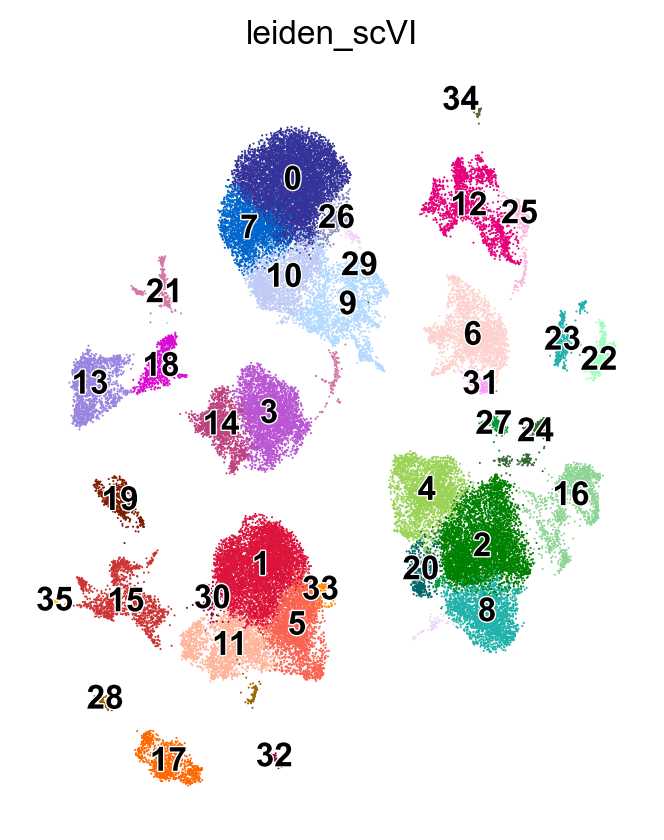

In [63]:
sc.pl.umap(adata_proc, color=['leiden_scVI'], legend_fontsize =float(12) , wspace=0.6, cmap=mymap2,palette=color2,
           legend_fontweight= 'bold', frameon= False , legend_loc='on data', legend_fontoutline=1, save=today+'_leiden_treated.png' )

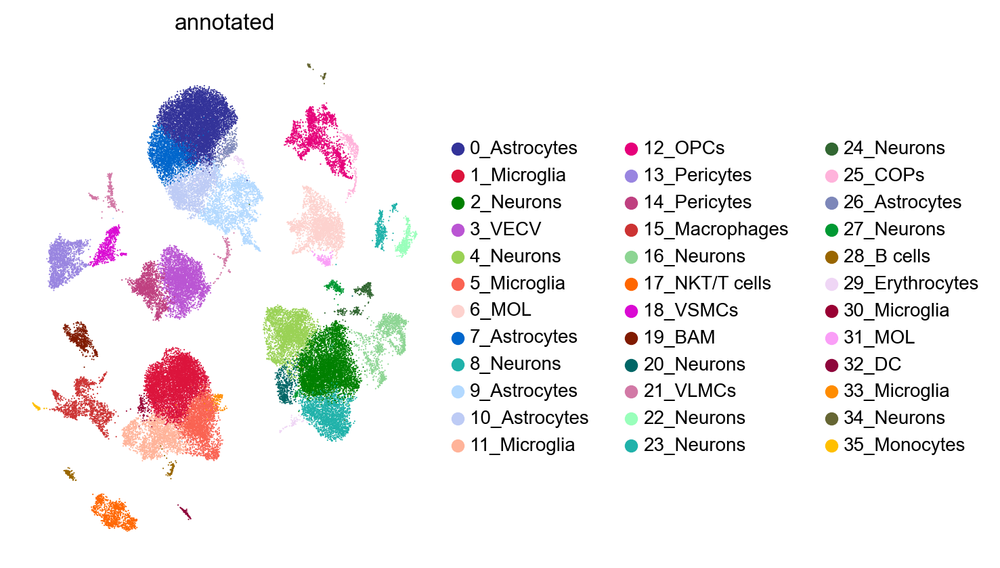

In [64]:
sc.pl.umap(adata_proc, color=['annotated'], legend_fontsize =float(10) , wspace=0.6, cmap=mymap2,palette=color2,
           legend_fontweight= 'normal', frameon= False, save=today+'_treated_annotated.png')

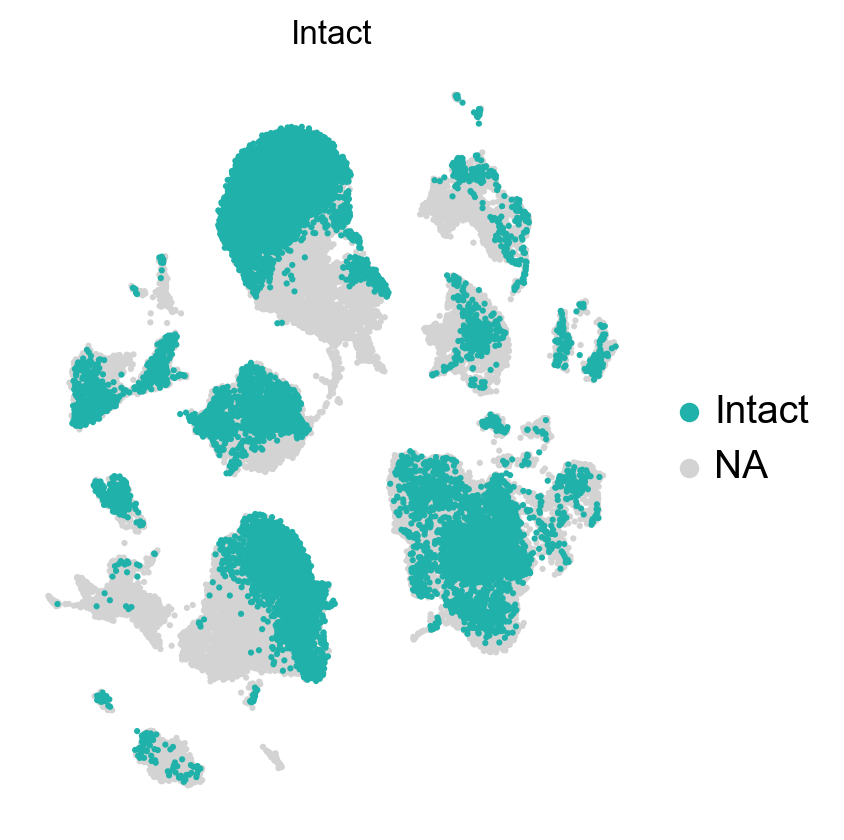

In [65]:
sc.pl.umap(adata_proc, color=['condition'], legend_fontsize =float(14) , title='Intact', groups='Intact',size=20,
           legend_fontweight= 'normal', frameon= False, save='_scVI2_intact.png')

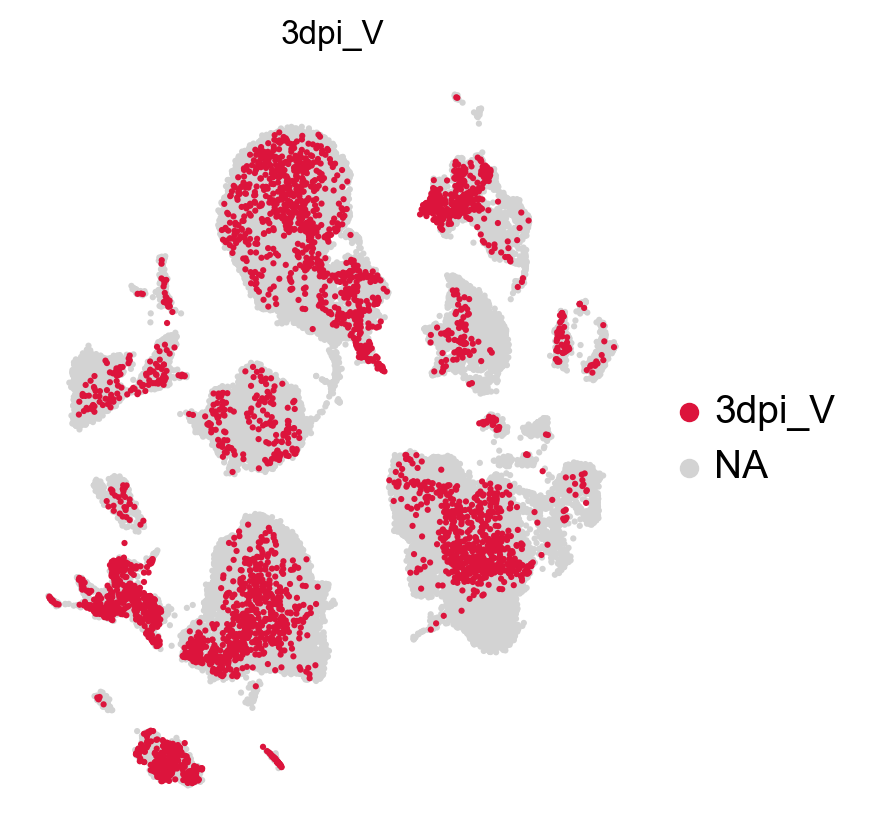

In [66]:
sc.pl.umap(adata_proc, color=['condition'], legend_fontsize =float(14) , wspace=0.6, cmap=mymap2,title='3dpi_V', groups='3dpi_V',size=20,
           legend_fontweight= 'normal', frameon= False, save='_scVI2_3dpi_V.png')

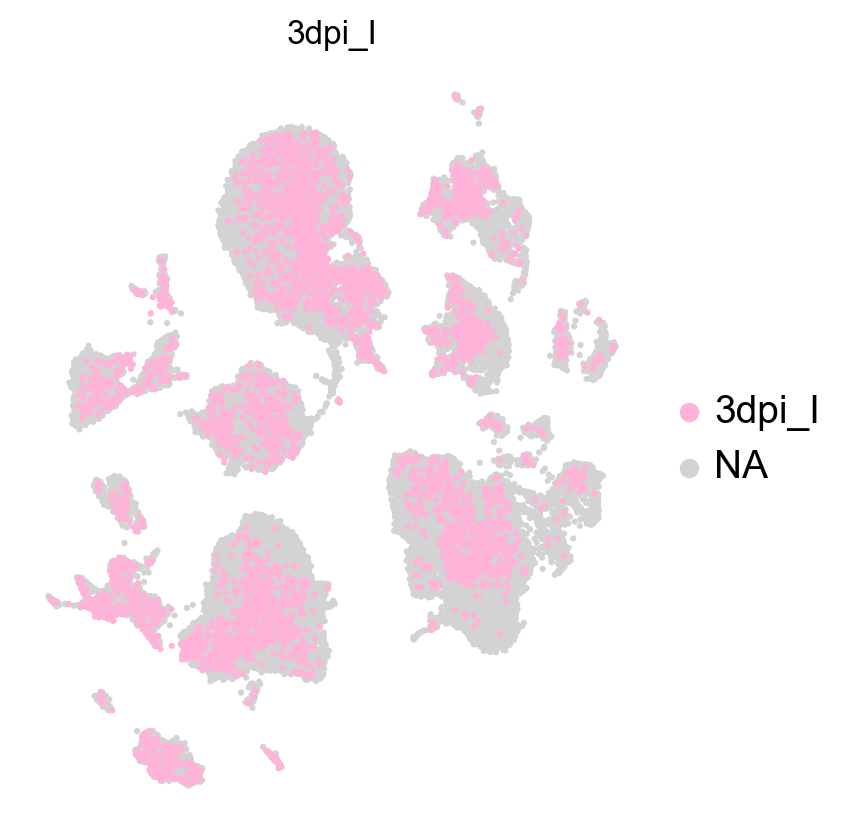

In [67]:
sc.pl.umap(adata_proc, color=['condition'], legend_fontsize =float(14) , wspace=0.6, cmap=mymap2,title='3dpi_I', groups='3dpi_I',size=20,
           legend_fontweight= 'normal', frameon= False, save='_scVI2_3dpi_I.png')

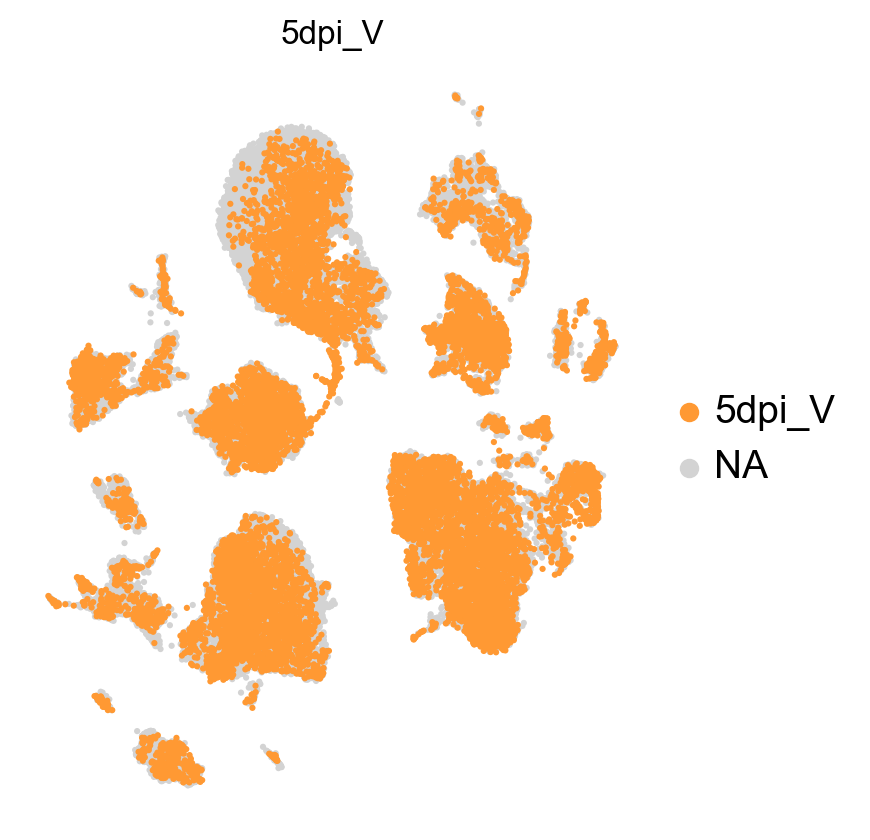

In [68]:
sc.pl.umap(adata_proc, color=['condition'], legend_fontsize =float(14) , wspace=0.6, cmap=mymap2,title='5dpi_V', groups='5dpi_V',size=20,
           legend_fontweight= 'normal', frameon= False, save='_scVI2_5dpi_V.png')

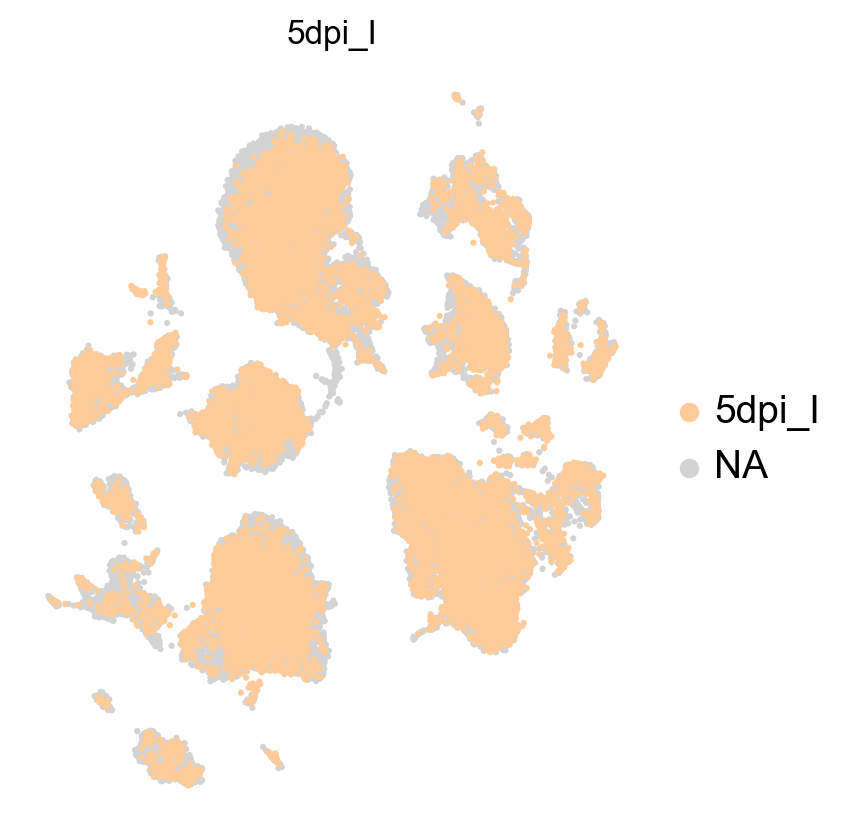

In [69]:
sc.pl.umap(adata_proc, color=['condition'], legend_fontsize =float(14) , wspace=0.6, cmap=mymap2,title='5dpi_I', groups='5dpi_I',size=20,
           legend_fontweight= 'normal', frameon= False, save='_scVI2_5dpi_I.png')

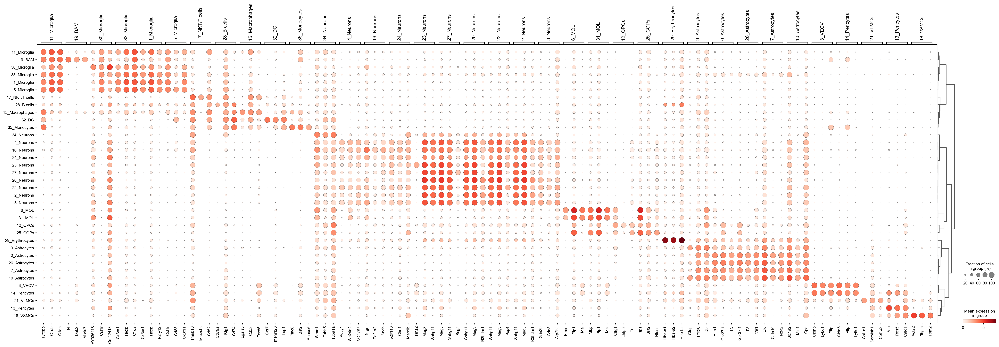

In [70]:
sc.pl.rank_genes_groups_dotplot(adata_proc, n_genes=3, key='rank_genes_treated_annotated', save='_scVI2_annotated.pdf')

In [71]:
result = adata_proc.uns['rank_genes_treated_annotated']
groups = result['names'].dtype.names
adata_annotated_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [72]:
adata_annotated_genes

,0_Astrocytes_n,0_Astrocytes_s,0_Astrocytes_p,0_Astrocytes_l,1_Microglia_n,1_Microglia_s,1_Microglia_p,1_Microglia_l,2_Neurons_n,2_Neurons_s,...,33_Microglia_p,33_Microglia_l,34_Neurons_n,34_Neurons_s,34_Neurons_p,34_Neurons_l,35_Monocytes_n,35_Monocytes_s,35_Monocytes_p,35_Monocytes_l
0,Htra1,215.232101,0.0,4.900856,Cx3cr1,218.044708,0.0,6.004050,Snhg11,161.985031,...,2.284152e-42,4.129344,Stmn1,18.663876,1.740298e-34,3.813418,Plac8,36.318882,1.753658e-67,8.883224
1,Gpr37l1,208.705368,0.0,5.094352,Hexb,210.503403,0.0,6.432406,Meg3,152.994263,...,7.282215e-41,4.669531,Tubb5,15.436574,1.791601e-32,3.644032,Bst2,36.303940,3.616355e-56,6.300346
2,F3,203.934631,0.0,5.015440,P2ry12,209.305389,0.0,6.129910,R3hdm1,136.424362,...,3.072164e-39,4.756132,Tuba1a,13.802546,4.824725e-28,3.378216,Rnase6,34.785828,2.017462e-52,8.381389
3,Plpp3,193.428909,0.0,4.901333,Csf1r,202.555984,0.0,5.763907,Kalrn,127.566368,...,5.754792e-40,4.668972,Nfib,13.013288,4.006630e-26,3.250310,Irf8,25.442610,8.294497e-54,5.871433
4,Slc7a10,190.035248,0.0,4.946088,Selplg,190.606354,0.0,5.727725,Camk2a,113.889435,...,4.616925e-41,4.149387,Stmn2,12.450315,2.010980e-24,3.548477,Ly6c2,23.761845,6.283170e-40,8.627516
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,Calm2,-70.111603,0.0,-1.695468,Gpm6b,-73.078659,0.0,-3.487521,Rps23,-77.448143,...,3.783555e-10,-2.172072,mt-Co1,-7.722914,3.479403e-12,-1.389711,Ptn,-8.267267,1.108515e-12,-3.401890
19286,Ly6e,-83.458000,0.0,-4.542246,Prnp,-76.736336,0.0,-3.354845,Sepp1,-78.630623,...,7.707431e-11,-2.591844,mt-Cytb,-7.754855,5.037661e-12,-1.406575,Cd63,-8.322093,1.362333e-12,-3.907644
19287,Mef2c,-85.306000,0.0,-3.301999,Sepw1,-77.279839,0.0,-2.623968,Cd63,-78.842079,...,1.885832e-13,-1.212802,mt-Nd2,-7.788391,1.852312e-12,-1.798390,Prnp,-8.602790,2.904130e-13,-3.576855
19288,App,-92.037895,0.0,-3.495178,Ptn,-80.584557,0.0,-3.652139,Rps9,-80.734009,...,1.572800e-13,-2.231033,Camk2n1,-7.820641,3.755537e-12,-3.177870,Ckb,-9.065245,3.591823e-15,-2.666612


In [73]:
adata_annotated_genes.to_csv('/Volumes/bzb/JN/Jovica/Manuscript_CK_VS/Paper_figures_raw files/Update_figures_100123/Main_figures/Fig.6/new_plots/'+today+'adata_annotated_treated_genes.csv')

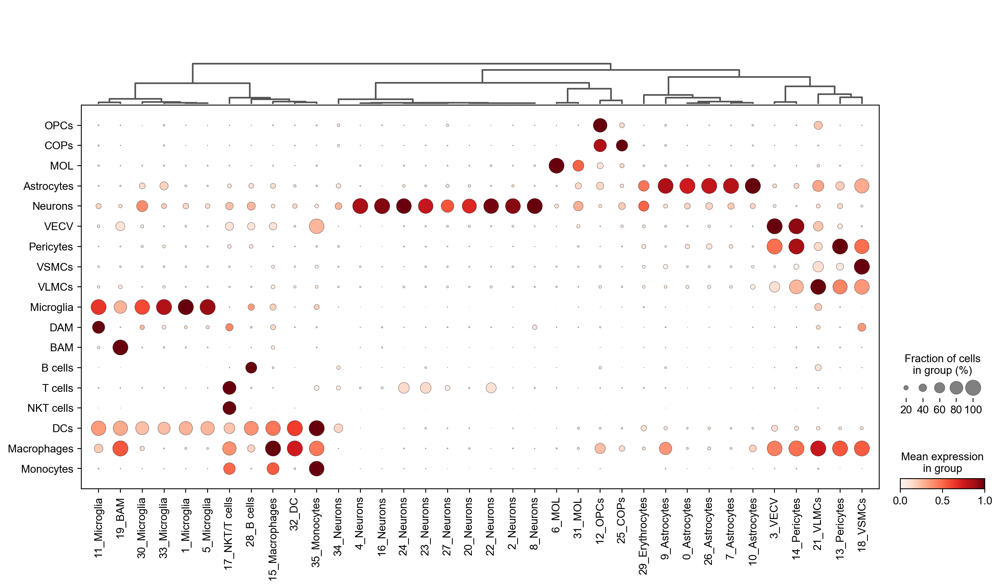

In [74]:
sc.pl.dotplot(adata_proc, ['OPCs','COPs', 'MOL',  'Astrocytes', 'Neurons','VECV','Pericytes', 'VSMCs', 'VLMCs',  'Microglia', 'DAM', 'BAM','B cells',  'T cells', 'NKT cells', 
                                   'DCs','Macrophages', 'Monocytes'],
              'annotated',  standard_scale='var', swap_axes=True, var_group_rotation=90, dendrogram=True,)# save='adata_proc_markers_treated_inj.png')


## Similarity matrix

In [75]:
adata_ctr= pd.read_csv('/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Paper_figures/220713/Figure3/tables/adata_annotated_genes.csv', index_col=0) #read file other condition
adata_ctr

,0_Astrocytes_n,0_Astrocytes_s,0_Astrocytes_p,0_Astrocytes_l,1_Microglia_n,1_Microglia_s,1_Microglia_p,1_Microglia_l,2_Neurons_n,2_Neurons_s,...,32_Neurons_p,32_Neurons_l,33_Monocytes_n,33_Monocytes_s,33_Monocytes_p,33_Monocytes_l,34_VLMCs_n,34_VLMCs_s,34_VLMCs_p,34_VLMCs_l
0,Slc7a10,137.710050,0.0,4.637773,Cx3cr1,177.888060,0.0,5.986088,Snhg11,137.743120,...,7.592519e-25,3.975896,Bst2,29.922733,1.121209e-39,6.249473,Mgp,21.735810,1.139787e-18,9.461661
1,Gpr37l1,135.453500,0.0,4.745870,P2ry12,172.807480,0.0,6.172631,Meg3,130.228730,...,1.213186e-25,3.806230,Plac8,29.704893,8.335792e-47,8.887366,Penk,18.154665,7.972077e-12,10.372695
2,Htra1,135.094280,0.0,4.488080,Hexb,169.732090,0.0,6.430142,R3hdm1,111.739190,...,2.613657e-21,3.519700,Rnase6,24.202963,5.445879e-32,8.264721,Igfbp6,15.218318,6.091328e-14,6.675347
3,F3,129.327130,0.0,4.528905,Csf1r,163.060460,0.0,5.747662,Kalrn,106.528510,...,1.611347e-18,3.368714,Irf8,23.298592,5.355509e-40,5.900719,Igfbp5,14.135590,5.104498e-14,6.264814
4,Plpp3,123.558395,0.0,4.508800,Selplg,160.763200,0.0,5.815565,Camk2a,97.934840,...,3.332796e-18,3.019462,Sell,21.657927,1.015805e-30,7.680125,Fbln1,13.717649,2.672902e-12,6.540889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,Junb,-52.293660,0.0,-3.907194,Prnp,-65.194830,0.0,-3.529326,Rps9,-65.903366,...,2.394150e-08,-1.467687,Glul,-7.046879,1.385209e-09,-3.675308,Mef2c,-4.015105,1.101703e-03,-4.344510
19286,Mef2c,-62.211050,0.0,-3.230517,Sepw1,-65.994705,0.0,-2.796657,Glul,-66.233540,...,2.371828e-08,-3.022721,Cd63,-7.048245,1.918036e-09,-3.855235,Tcf4,-4.021686,6.316321e-04,-2.480477
19287,Ly6e,-63.201374,0.0,-4.713518,mt-Co1,-66.846370,0.0,-1.956244,Sepp1,-66.677150,...,1.120994e-08,-1.435337,Ptn,-7.059607,1.672182e-09,-3.479979,Syt11,-4.090808,1.101737e-03,-30.498886
19288,App,-65.350430,0.0,-3.439053,Ptn,-68.046150,0.0,-3.846108,Cd63,-67.120770,...,8.336101e-09,-3.197100,Ckb,-7.682024,2.670972e-11,-2.693257,Gpm6a,-4.481155,4.700965e-04,-5.081278


In [76]:
Control = dict()
Control['0_Astrocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['0_Astrocytes_n'].dropna().head(20))]
Control['1_Microglia'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['1_Microglia_n'].dropna().head(20))]
Control['2_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['2_Neurons_n'].dropna().head(20))]
Control['3_Astrocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['3_Astrocytes_n'].dropna().head(20))]
Control['4_VECV'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['4_VECV_n'].dropna().head(20))]
Control['5_Microglia'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['5_Microglia_n'].dropna().head(20))]
Control['6_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['6_Neurons_n'].dropna().head(20))]
Control['7_MOL'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['7_MOL_n'].dropna().head(20))]
Control['8_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['8_Neurons_n'].dropna().head(20))]
Control['9_Microglia'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['9_Microglia_n'].dropna().head(20))]
Control['10_Pericytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['10_Pericytes_n'].dropna().head(20))]
Control['11_Astrocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['11_Astrocytes_n'].dropna().head(20))]
Control['12_Monocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['12_Monocytes_n'].dropna().head(20))]
Control['13_OPCs'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['13_OPCs_n'].dropna().head(20))]
Control['14_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['14_Neurons_n'].dropna().head(20))]
Control['15_NKT/T cells'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['15_NKT/T cells_n'].dropna().head(20))]
Control['16_Astrocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['16_Astrocytes_n'].dropna().head(20))]
Control['17_BAM'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['17_BAM_n'].dropna().head(20))]
Control['18_VSMCs'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['18_VSMCs_n'].dropna().head(20))]
Control['19_COPs'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['19_COPs_n'].dropna().head(20))]
Control['20_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['20_Neurons_n'].dropna().head(20))]
Control['21_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['21_Neurons_n'].dropna().head(20))]
Control['22_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['22_Neurons_n'].dropna().head(20))]
Control['23_VLMCs'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['23_VLMCs_n'].dropna().head(20))]
Control['24_Erythrocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['24_Erythrocytes_n'].dropna().head(20))]
Control['25_Astrocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['25_Astrocytes_n'].dropna().head(20))]
Control['26_Astrocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['26_Astrocytes_n'].dropna().head(20))]
Control['27_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['27_Neurons_n'].dropna().head(20))]
Control['28_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['28_Neurons_n'].dropna().head(20))]
Control['29_B cells'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['29_B cells_n'].dropna().head(20))]
Control['30_MOL'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['30_MOL_n'].dropna().head(20))]
Control['31_DC'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['31_DC_n'].dropna().head(20))]
Control['32_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['32_Neurons_n'].dropna().head(20))]
Control['33_Monocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['33_Monocytes_n'].dropna().head(20))]
Control['34_VLMCs'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['34_VLMCs_n'].dropna().head(20))]

In [77]:
plt.rcParams['figure.figsize']=(10,9) #rescale figuressc.logging.print_header()

In [78]:
adata_proc

AnnData object with n_obs × n_vars = 53813 × 19290
    obs: 'sample_id', 'sample_id_str', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'sample', 'experiment', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'cell_cycle', 'Microglia', 'DAM', 'Macrophages', 'BAM', 'Monocytes', 'DCs', 'NKT cells', 'T cells', 'B cells', 'Neutrophils', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VECV', 'annotated', 'sample_IDs', 'condition_paper'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', '

In [79]:
cell_annotation_norm_micro = sc.tl.marker_gene_overlap(adata_proc, Control, key='rank_genes_treated_annotated', normalize='reference')

Text(0.5, 241.44097222222217, 'Control & Inhibitors')

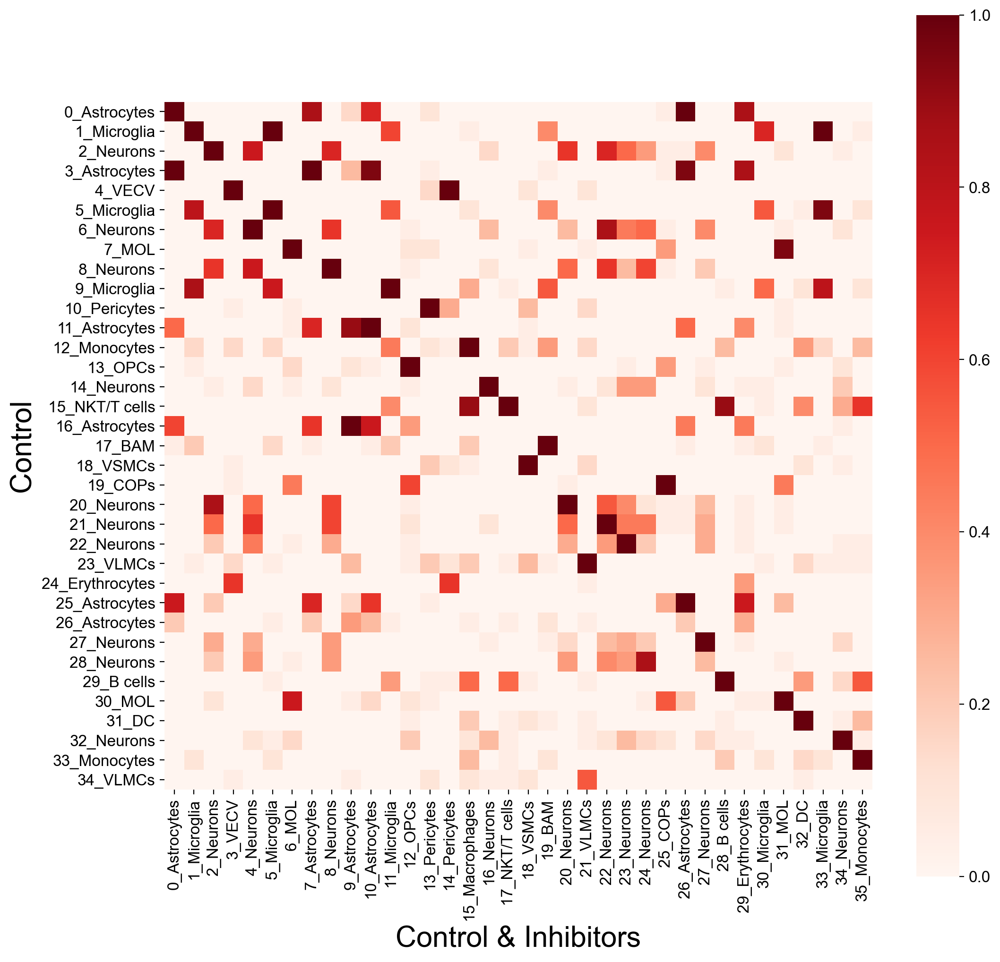

In [80]:
plt.figure(figsize=(12,12))
chart = sb.heatmap(cell_annotation_norm_micro, cbar=True,  cmap='Reds',square=True,vmin=0)
plt.yticks(rotation=0)
plt.ylabel('Control', fontsize=22)
plt.xlabel('Control & Inhibitors', fontsize=22)
plt.savefig('/Volumes/bzb/JN/Jovica/Manuscript_CK_VS/Paper_figures_raw files/Update_figures_100123/Main_figures/Fig.6/new_plots/all_simmatris2v2.png', dpi=300)


# Split cell populations

In [81]:
adata_proc.obs['annotated'].value_counts()

0_Astrocytes       7690
1_Microglia        5546
2_Neurons          5227
3_VECV             3338
4_Neurons          2709
5_Microglia        2659
6_MOL              2398
7_Astrocytes       2343
8_Neurons          2107
9_Astrocytes       2098
10_Astrocytes      2028
11_Microglia       1971
12_OPCs            1841
13_Pericytes       1735
14_Pericytes       1372
15_Macrophages     1332
16_Neurons         1251
17_NKT/T cells      925
18_VSMCs            669
19_BAM              596
20_Neurons          472
21_VLMCs            424
22_Neurons          417
23_Neurons          407
24_Neurons          335
25_COPs             324
26_Astrocytes       295
27_Neurons          254
28_B cells          206
29_Erythrocytes     148
30_Microglia        148
31_MOL              146
32_DC               129
33_Microglia        128
34_Neurons           74
35_Monocytes         71
Name: annotated, dtype: int64

In [82]:
adata_all_astros_treated = adata_proc[np.in1d(adata_proc.obs['annotated'], 
                           ['0_Astrocytes', '3_Astrocytes','9_Astrocytes','11_Astrocytes','27_Astrocytes'])].copy()

In [83]:
adata_all_astros_treated.write('/Volumes/bzb/JN/Jovica/Manuscript_CK_VS/notebooks/h5ad/'+today+'adata_all_astros_treated_scVI.h5ad', compression='gzip')

In [84]:
adata_all_oligos_treated = adata_proc[np.in1d(adata_proc.obs['annotated'], 
                           ['7_MOL', '12_OPCs','26_COPs','30_MOL'])].copy()

In [85]:
adata_all_oligos_treated.write('/Volumes/bzb/JN/Jovica/Manuscript_CK_VS/notebooks/h5ad/'+today+'adata_all_oligos_treated_scVI.h5ad',compression='gzip')

In [86]:
adata_all_micro_treated = adata_proc[np.in1d(adata_proc.obs['annotated'], 
                           ['2_Microglia', '5_Microglia','8_Microglia', '24_Microglia'])].copy()

In [88]:
adata_all_micro_treated.write('/Volumes/bzb/JN/Jovica/Manuscript_CK_VS/notebooks/h5ad/'+today+'adata_all_micro_treated_scVI.h5ad',compression='gzip')